In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

In [3]:
import os
import numpy as np
import pickle
from tess_backml import PACKAGEDIR, Background_Data
import matplotlib.pyplot as plt

In [2]:
sector = 2
camera = 2
ccd = 4

In [3]:
bkg_data = Background_Data(
        sector=sector, camera=camera, ccd=ccd, img_bin=16, downsize="binning"
    )
print(bkg_data)

TESS FFI Background object (Sector, Camera, CCD, N times): 2, 2, 4, 1245


Computing sector darkest frames...
Computing star mask...


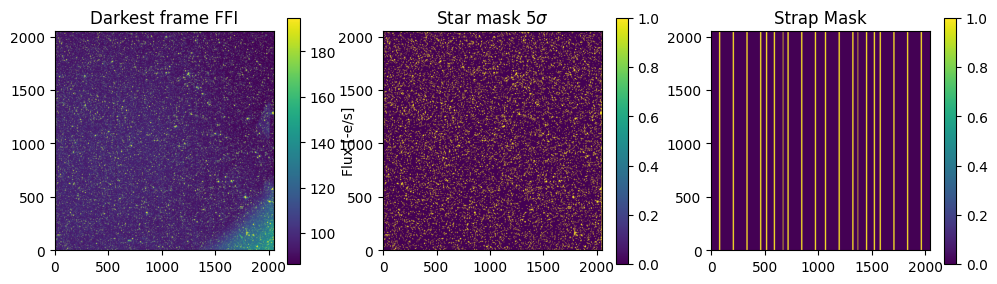

Getting FFI flux cube...
Computing average static scene from darkes frames...
ERROR:asyncio:Task exception was never retrieved
future: <Task finished name='Task-6005' coro=<async_get_ffi() done, defined at /home/jorgemarpa/envs/conda/tess-bkg/lib/python3.10/site-packages/tesscube/query.py:650> exception=KeyboardInterrupt()>
Traceback (most recent call last):
  File "/home/jorgemarpa/envs/conda/tess-bkg/lib/python3.10/site-packages/IPython/core/interactiveshell.py", line 3579, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_787/1695450860.py", line 1, in <module>
    bkg_data.get_scatter_light_cube()
  File "/home/jorgemarpa/projects/tess-backml/src/tess_backml/database/bkg_data.py", line 271, in get_scatter_light_cube
    flux_cube = []
  File "/home/jorgemarpa/projects/tess-backml/src/tess_backml/database/bkg_data.py", line 318, in _get_static_scene
    print("Computing average static scene from darkes frames...")
  File "/home/jorgemarpa/proje

Iterating frames: 100%|██████████| 1245/1245 [37:40<00:00,  1.82s/it]


In [66]:
bkg_data.get_scatter_light_cube(frames=None, mask_straps=True, plot=True)

In [71]:
bkg_data.scatter_cube[750]

array([[ 0.47758484,  0.38642502,  0.34154129, ..., -0.19993591,
        -0.30109406, -0.2252655 ],
       [ 0.4394455 ,  0.38532257,  0.34667206, ..., -0.07783508,
        -0.2118454 , -0.28257751],
       [ 0.36164856,  0.37002563,  0.36056137, ..., -0.08266449,
        -0.14985657, -0.27500916],
       ...,
       [ 0.31025696,  0.2990799 ,  0.16031265, ...,  0.10733795,
         0.09171295,  0.03295788],
       [ 0.27279663,  0.19979858,  0.15613937, ...,  0.08481598,
         0.09889603,  0.08030763],
       [ 0.29537582,  0.17690277,  0.25307083, ...,  0.11388016,
         0.03861237,  0.12543869]])

In [73]:
fig_dir = f"{os.path.dirname(os.path.dirname(PACKAGEDIR))}/data/figures/sector{sector:03}"
if not os.path.isdir(fig_dir):
    os.makedirs(fig_dir)
fig_file = f"{fig_dir}/ffi_scatterlight_bin{bkg_data.img_bin}_sector{bkg_data.sector:03}_{bkg_data.camera}-{bkg_data.ccd}.gif"
print(fig_file)

bkg_data.animate_data(data="sl", file_name=fig_file, save=False, step=2)

/home/jorgemarpa/projects/tess-backml/data/figures/sector002/ffi_scatterlight_bin16_sector002_2-4.gif
INFO:matplotlib.animation:Animation.save using <class 'matplotlib.animation.HTMLWriter'>


In [74]:
bkg_data.get_vector_maps()

INFO:root:Retrieving TESSVector from: https://heasarc.gsfc.nasa.gov/docs/tess/data/TESSVectors/Vectors/FFI_Cadence/TessVectors_S002_C2_FFI.csv


 98%|█████████▊| 1225/1245 [00:01<00:00, 619.43it/s]/home/jorgemarpa/envs/conda/tess-bkg/lib/python3.10/site-packages/astropy/units/quantity.py:666: RuntimeWarning: divide by zero encountered in divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/jorgemarpa/envs/conda/tess-bkg/lib/python3.10/site-packages/astropy/units/quantity.py:666: RuntimeWarning: invalid value encountered in divide
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
/home/jorgemarpa/envs/conda/tess-bkg/lib/python3.10/site-packages/astropy/units/quantity.py:666: RuntimeWarning: invalid value encountered in arcsin
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)
100%|██████████| 1245/1245 [00:01<00:00, 668.47it/s]


In [75]:
data_dir = f"{os.path.dirname(os.path.dirname(PACKAGEDIR))}/data/bkg_data/sector{sector:03}"
if not os.path.isdir(data_dir):
    os.makedirs(data_dir)
out_file = f"{data_dir}/ffi_cube_bin{bkg_data.img_bin}_sector{bkg_data.sector:03}_{bkg_data.camera}-{bkg_data.ccd}.npz"

bkg_data.save_data(out_file=out_file)

In [ ]:
"/home/jorgemarpa/envs/conda/tess-bkg/bin/python"